<a href="https://colab.research.google.com/github/dlyalin20/APCS_Project_One/blob/master/daniel_heatmap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
#temp at time = t and dt as inputs, temp at time = t + dt as outputs
#dt is a 2D matrix, output is a 2D matrix
#use convolutional neural network
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras


temp = []

for n in range (70, 371):
  n_int = str(1000 * n)
  f = '/content/drive/My Drive/ML/csv/heatmap.' + n_int + '.csv'
  df = pd.read_csv(f)
  temp.append(df['temp(K)'].values)

temp = np.array(temp)

temp_reshape = temp.reshape(-1, 1)

scaler = MinMaxScaler()
normalized = scaler.fit_transform(temp_reshape)

normalized_matrix = normalized.reshape(301, 47, 47, 1)

temp_in = normalized_matrix[:-1]

temp_out = normalized_matrix[1:]

for n in range(1, 61):
  m = 5 * n
  inputs = normalized_matrix[:-m]
  temp_in = np.concatenate((temp_in, inputs))
  
  outputs = normalized_matrix[m:]
  temp_out = np.concatenate((temp_out, outputs))

dt = []

for n in range (47 * 47 * (300)):
  dt.append(1 / 300)

for m in range (1, 61):
  for n in range (47 * 47 * (301 - 5 * m)):
    dt.append(5 * m / 300)

dt = np.array(dt)

dt_reshape = dt.reshape(temp_in.shape)

visible_1 = keras.Input(shape = temp_in.shape[1:])
cnn_1 = keras.layers.Conv2D(128, kernel_size = (3, 3), padding = 'same', activation = 'relu')(visible_1)
dropout_1 = keras.layers.Dropout(0.1)(cnn_1)

visible_2 = keras.Input(shape = dt_reshape.shape[1:])

merge = keras.layers.Concatenate(axis = 3)([dropout_1, visible_2])

cnn_2 = keras.layers.Conv2D(64, kernel_size = (3, 3), padding = 'same', activation = 'relu')(merge)
dropout_2 = keras.layers.Dropout(0.1)(cnn_2)

output = keras.layers.Conv2D(1, kernel_size = (3, 3), padding = 'same', activation = 'relu')(dropout_2)

model = keras.Model(inputs = [visible_1, visible_2], outputs = output)

model.compile(loss = 'mse', optimizer = keras.optimizers.Adam(lr = 1e-3, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                        patience = 5, verbose = 1, mode = 'auto',
                                        restore_best_weights = True)

reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00000001)

history = model.fit([temp_in, dt_reshape], temp_out, validation_split = 0.2, epochs = 100, callbacks=[reduce_lr, monitor])



Epoch 1/100
231/231 [==============================] - 3s 14ms/step - loss: 2.7891e-04 - val_loss: 3.0343e-04 - lr: 0.0010
Epoch 2/100
231/231 [==============================] - 3s 13ms/step - loss: 9.7469e-05 - val_loss: 1.8391e-04 - lr: 0.0010
Epoch 3/100
231/231 [==============================] - 3s 13ms/step - loss: 8.1550e-05 - val_loss: 1.6082e-04 - lr: 0.0010
Epoch 4/100
231/231 [==============================] - 3s 13ms/step - loss: 7.4970e-05 - val_loss: 1.1515e-04 - lr: 0.0010
Epoch 5/100
231/231 [==============================] - 3s 13ms/step - loss: 7.3765e-05 - val_loss: 1.3364e-04 - lr: 0.0010
Epoch 6/100
231/231 [==============================] - 3s 13ms/step - loss: 7.1010e-05 - val_loss: 1.3260e-04 - lr: 0.0010
Epoch 00006: early stopping


In [ ]:
#prediction for convolutional neural network
#3D plot of predicted heatmap
time = 70000
time_step = 300

pred_time = time + time_step * 1000

input_time = int(time / 1000 - 70)
print(input_time)

dt = []

for n in range (47 * 47):
  dt.append(time_step / 300)

dt = np.array(dt)
print(dt.shape)
print(dt)

input_dt = dt.reshape(1, 47, 47, 1)
print(input_dt.shape)
print(input_dt)

predict = model.predict([temp_in[[input_time]], input_dt])
print(predict.shape)
print(predict)

predict_matrix = predict.reshape(47, 47)
print(predict_matrix.shape)
print(predict_matrix)

inverse = scaler.inverse_transform(predict_matrix)
print(inverse.shape)
print(inverse)

pred_temp = inverse.reshape(2209)
print(pred_temp.shape)
print(pred_temp)

x = df['x(nm)'].values
z = df['z(nm)'].values

xx = np.linspace(min(x), max(x), 47)
zz = np.linspace(min(z), max(z), 47)
X, Z = np.meshgrid(xx, zz)
TEMP = griddata((x, z), pred_temp, (X, Z), method = 'linear')

ax = plt.axes(projection = '3d')
ax.plot_surface(X, Z, TEMP, cmap = 'jet')
ax.set_title(pred_time)
ax.set_xlabel('x(nm)')
ax.set_ylabel('z(nm)')
ax.set_zlabel('temp(K)');

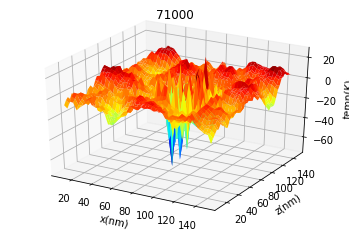

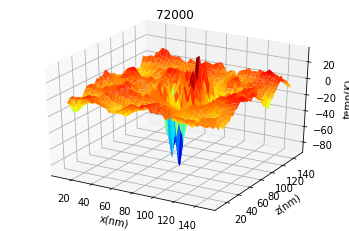

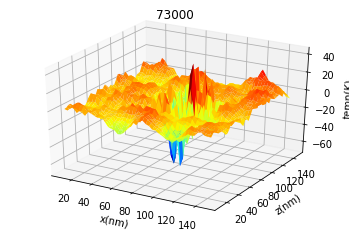

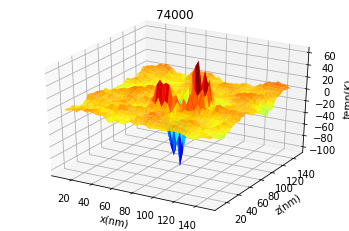

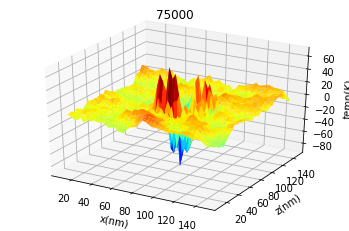

...

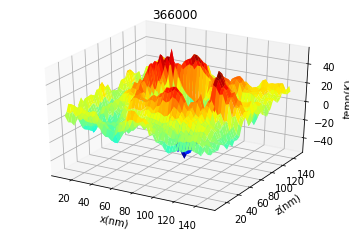

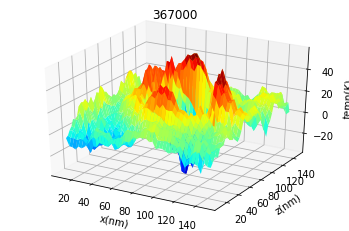

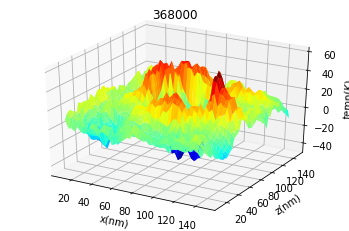

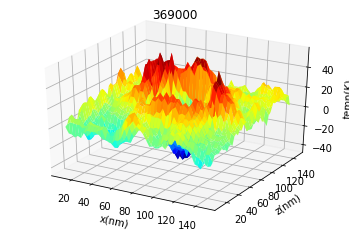

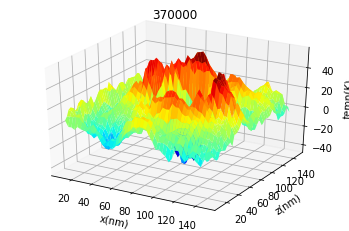

In [ ]:
#plots differences between each prediction and real

import csv

time = 70000
overall = []


for n in range(1, 301):
  time_step = n
  pred_time = time + time_step * 1000

  input_time = int(time / 1000 - 70)

  dt = []

  for m in range (47 * 47):
    dt.append(time_step / 300)

  dt = np.array(dt)

  input_dt = dt.reshape(1, 47, 47, 1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(2209)

  pred_time_str = str(pred_time)

  f = "/content/drive/My Drive/ML/csv/heatmap." + pred_time_str + ".csv"

  differences = []

  pointer = 0

  with open(f, "r") as fp:
    df = pd.read_csv(fp)
  x, z, tmp = df['x(nm)'].values, df['z(nm)'].values, df['temp(K)'].values
  for item in tmp:
    dif = item - pred_temp[pointer]
    pointer += 1
    differences.append(dif)
  differences = np.array(differences)
  overall.append(differences)
  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), differences, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(pred_time)
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  plt.show()
  plt.clf()
  plt.close()

overall = np.array(overall)

In [ ]:
#creates np array of mse between each prediction and real

import csv
import sklearn.metrics as skm

time = 70000
overall_error = []


for n in range(1, 301):
  time_step = n
  pred_time = time + time_step * 1000

  input_time = int(time / 1000 - 70)

  dt = []

  for m in range (47 * 47):
    dt.append(time_step / 300)

  dt = np.array(dt)

  input_dt = dt.reshape(1, 47, 47, 1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(2209)

  pred_time_str = str(pred_time)

  f = "/content/drive/My Drive/ML/csv/heatmap." + pred_time_str + ".csv"


  with open(f, "r") as fp:
    df = pd.read_csv(fp)

  x, z, tmp = df['x(nm)'].values, df['z(nm)'].values, df['temp(K)'].values

  error = skm.mean_squared_error(tmp, pred_temp)
  overall_error.append(error)

overall_error = np.array(overall_error)

In [ ]:
#brief statistical analysis of overall_error array

print(overall_error)
print("Max:", max(overall_error), "\n","Min:", min(overall_error), "\n", "Mean:", np.mean(overall_error))

[ 69.45632614  78.48822448  78.67533023  93.62941056 100.34676275
 100.10668322 116.92325808 128.40302223  67.81185682 146.68746971
 111.62745355  98.15468251 112.95160504  86.52687824 101.59361165
 119.97342462 115.27257345  75.73406742  86.52854485  73.73314802
  97.09123673  71.44147807  84.91011562  59.0672532   78.14924919
  78.97983425  72.6900208   68.34530799  64.97039403  61.73961629
  59.80912546  79.04052895  55.41651558  61.01685026  62.84119626
  69.90686283  56.32274637  57.38833673  80.33955893  63.54621874
  59.0819638   48.28544425  77.32138019  61.69959387  68.41018979
  70.62633416  64.07352696  59.38021022  57.42069032  69.68003621
  67.58437925  65.5781386   64.70643106  81.40959559  63.61852615
  94.28501573  81.45636109  56.98566852  72.7229813   68.68577402
  76.47160669  68.99087016  73.49922727  67.30640766  56.25908491
  80.64650053  67.2333364   84.79991058  93.09097313  68.28022759
  72.70872368  62.21604419  66.22069783  76.12517224  71.83705855
  75.73208

In [ ]:
#saves every single predicted heatmap

time = 70000

with open("/content/drive/My Drive/ML/csv/heatmap.70000.csv", "r") as f:
  df = pd.read_csv(f)
  x = df['x(nm)'].values
  z = df['z(nm)'].values
  x, z = np.array(x), np.array(z)

for n in range(1, 301):
  time_step = n
  pred_time = time + time_step * 1000

  input_time = int(time / 1000 - 70)

  dt = []

  for m in range (47 * 47):
    dt.append(time_step / 300)

  dt = np.array(dt)

  input_dt = dt.reshape(1, 47, 47, 1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(2209)

  pred_time_str = str(pred_time)

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), pred_temp, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(pred_time_str)
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  ax.set_zlim(300, 1200)
  plt.savefig("/content/drive/My Drive/ML/" + pred_time_str)
  plt.clf()
  plt.close()


In [ ]:
#creates error maps

import csv
import sklearn.metrics as skm

time = 70000
overall_error = []


for n in range(1, 301):
  time_step = n
  pred_time = time + time_step * 1000

  input_time = int(time / 1000 - 70)

  dt = []

  for m in range (47 * 47):
    dt.append(time_step / 300)

  dt = np.array(dt)

  input_dt = dt.reshape(1, 47, 47, 1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(2209)

  pred_time_str = str(pred_time)

  f = "/content/drive/My Drive/ML/csv/heatmap." + pred_time_str + ".csv"


  with open(f, "r") as fp:
    df = pd.read_csv(fp)

  x, z, tmp = df['x(nm)'].values, df['z(nm)'].values, df['temp(K)'].values

  difs = []

  pointer = 0

  for item in tmp:
    dif = float(item) - pred_temp[pointer]
    difs.append(dif)
    pointer += 1
  
  difs = np.array(difs)

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), difs, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(pred_time_str)
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  ax.set_zlim(-80, 80)
  plt.savefig("/content/drive/My Drive/ML/error maps/" + pred_time_str)
  plt.clf()
  plt.close()




In [ ]:
# applying frame interpolation to CNN

#temp at time = t and dt as inputs, temp at time = t + dt as outputs
#dt is a 2D matrix, output is a 2D matrix
#use convolutional neural network
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras


temp = []

for n in range (70, 371):
  n_int = str(1000 * n)
  f = '/content/drive/My Drive/ML/csv/heatmap.' + n_int + '.csv'
  df = pd.read_csv(f)
  temp.append(df['temp(K)'].values)

temp = np.array(temp)

temp_reshape = temp.reshape(-1, 1)

scaler = MinMaxScaler()
normalized = scaler.fit_transform(temp_reshape)

normalized_matrix = normalized.reshape(301, 47, 47, 1)

temp_in1 = normalized_matrix[:-2]
temp_in2 = normalized_matrix[2:]
temp_out = normalized_matrix[1:-1]


visible_1 = keras.Input(shape = temp_in1.shape[1:])
cnn_1 = keras.layers.Conv2D(128, kernel_size = (3, 3), padding = 'same', activation = 'relu')(visible_1)
dropout_1 = keras.layers.Dropout(0.1)(cnn_1)

visible_2 = keras.Input(shape = temp_in2.shape[1:])
cnn_2 = keras.layers.Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu')(visible_2)
dropout_2 = keras.layers.Dropout(0.1)(cnn_2)

merge = keras.layers.Concatenate(axis=3)([dropout_1, dropout_2])

cnn_3 = keras.layers.Conv2D(64, kernel_size = (3, 3), padding = 'same', activation = 'relu')(merge)
dropout_3 = keras.layers.Dropout(0.1)(cnn_3)

output = keras.layers.Conv2D(1, kernel_size = (3, 3), padding = 'same', activation = 'relu')(dropout_3)

model = keras.Model(inputs = [visible_1, visible_2], outputs = output)

model.compile(loss = 'mse', optimizer = keras.optimizers.Adam(lr = 1e-3, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                      patience = 5, verbose = 1, mode = 'auto',
                                      restore_best_weights = True)

history = model.fit([temp_in1, temp_in2], temp_out, validation_split = 0.1, epochs = 100, callbacks=[monitor])



Epoch 1/100
9/9 [==============================] - 0s 55ms/step - loss: 0.0027 - val_loss: 5.5817e-04
Epoch 2/100
9/9 [==============================] - 0s 18ms/step - loss: 4.1571e-04 - val_loss: 1.2774e-04
Epoch 3/100
9/9 [==============================] - 0s 18ms/step - loss: 2.3456e-04 - val_loss: 6.1277e-05
Epoch 4/100
9/9 [==============================] - 0s 18ms/step - loss: 1.6806e-04 - val_loss: 5.7757e-05
Epoch 5/100
9/9 [==============================] - 0s 19ms/step - loss: 1.4639e-04 - val_loss: 5.3562e-05
Epoch 6/100
9/9 [==============================] - 0s 19ms/step - loss: 1.3352e-04 - val_loss: 5.0709e-05
Epoch 00006: early stopping


(1, 47, 47, 1)
[[[[0.03703501]
   [0.03588591]
   [0.0373257 ]
   ...
   [0.0381427 ]
   [0.03832607]
   [0.0361944 ]]

  [[0.03970092]
   [0.03661199]
   [0.03771468]
   ...
   [0.03749112]
   [0.03787159]
   [0.03681229]]

  [[0.04047047]
   [0.03699674]
   [0.03746146]
   ...
   [0.0348298 ]
   [0.03612735]
   [0.0356257 ]]

  ...

  [[0.03690867]
   [0.03882631]
   [0.03893351]
   ...
   [0.03946015]
   [0.04004131]
   [0.04016938]]

  [[0.03691156]
   [0.03888539]
   [0.0398578 ]
   ...
   [0.03875261]
   [0.04042212]
   [0.04027597]]

  [[0.03809237]
   [0.0427345 ]
   [0.04324542]
   ...
   [0.03513923]
   [0.03520115]
   [0.03638351]]]]
(47, 47)
[[0.03703501 0.03588591 0.0373257  ... 0.0381427  0.03832607 0.0361944 ]
 [0.03970092 0.03661199 0.03771468 ... 0.03749112 0.03787159 0.03681229]
 [0.04047047 0.03699674 0.03746146 ... 0.0348298  0.03612735 0.0356257 ]
 ...
 [0.03690867 0.03882631 0.03893351 ... 0.03946015 0.04004131 0.04016938]
 [0.03691156 0.03888539 0.0398578  ... 0.

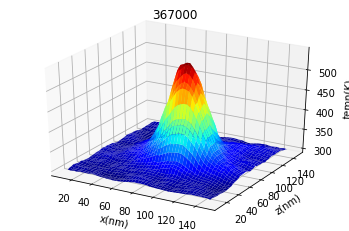

In [ ]:
#prediction for convolutional neural network
#3D plot of predicted heatmap
from scipy.interpolate import griddata 
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

time1 = 366000
time2 = 368000

pred_time = int((time1 + time2) / 2)
input_time1 = int(time1 / 1000 - 70)
input_time2 = int(time2 / 1000 - 70)

predict = model.predict([temp_in1[[input_time1]], temp_in1[[input_time2]]])
print(predict.shape)
print(predict)

predict_matrix = predict.reshape(47, 47)
print(predict_matrix.shape)
print(predict_matrix)

inverse = scaler.inverse_transform(predict_matrix)
print(inverse.shape)
print(inverse)

pred_temp = inverse.reshape(2209)
print(pred_temp.shape)
print(pred_temp)

x = df['x(nm)'].values
z = df['z(nm)'].values

xx = np.linspace(min(x), max(x), 47)
zz = np.linspace(min(z), max(z), 47)
X, Z = np.meshgrid(xx, zz)
TEMP = griddata((x, z), pred_temp, (X, Z), method = 'linear')

fig = plt.figure()
ax = plt.axes(projection = '3d')
ax.plot_surface(X, Z, TEMP, cmap = 'jet')
ax.set_title(pred_time)
ax.set_xlabel('x(nm)')
ax.set_ylabel('z(nm)')
ax.set_zlabel('temp(K)');

In [ ]:
# obtaining MSE arrays between predicted and real, averaged and real, and averaged and predicted
from sklearn.metrics import mean_squared_error
from scipy.interpolate import griddata 
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

#real_v_pred = []
#real_v_avg = []
#avg_v_pred = []

for n in range(70, 367):
  real_v_pred = []
  #real_v_avg = []
  time1 = n*1000
  time2 = (n+2)*1000

  pred_time = int((time1 + time2) / 2)
  input_time1 = int(time1 / 1000 - 70)
  input_time2 = int(time2 / 1000 - 70)
  predict = model.predict([temp_in1[[input_time1]], temp_in1[[input_time2]]])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)
  pred_temp = inverse.reshape(2209)
  pred_str = str(pred_time)

  with open("/content/drive/My Drive/ML/csv/heatmap." + pred_str + ".csv", "r") as f:
    df = pd.read_csv(f)
    real_temp = df['temp(K)'].values
  #with open("/content/drive/My Drive/ML/csv/heatmap." + str(time2) + ".csv", "r") as f:
    #df = pd.read_csv(f)
    #temp_1 = df['temp(K)'].values
  #with open("/content/drive/My Drive/ML/csv/heatmap." + str(time1) + ".csv", "r") as f:
    #df = pd.read_csv(f)
    #temp_2 = df['temp(K)'].values
  #real_v_pred.append(mean_squared_error(real_temp, pred_temp))
  #avgs = []
  #counter = 0
  #while (counter) < len(real_temp):
    #avg_value = (temp_1[counter] + temp_2[counter])/2
    #avgs.append(avg_value)
    #counter += 1
  counter = 0
  while counter < len(real_temp):
    real_v_pred.append(real_temp[counter] - pred_temp[counter])
    #real_v_avg.append(real_temp[counter] - avgs[counter])
    counter += 1
  
  real_v_pred = np.array(real_v_pred)
  #real_v_avg = np.array(real_v_avg)

  x = df['x(nm)'].values
  z = df['z(nm)'].values

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), real_v_pred, (X, Z), method = 'linear')
  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title("Real Versus Predicted Values for: " + pred_str)
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  ax.set_zlim(0, 200)
  plt.savefig("/content/drive/My Drive/ML/Real_V_Predicted/Real Versus Predicted Values for: " + pred_str)
  plt.clf()
  plt.close()
  #TEMP = griddata((x, z), real_v_avg, (X, Z), method = 'linear')
  #ax = plt.axes(projection = '3d')
  #ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  #ax.set_title("Real Versus Average Values for: " + pred_str)
  #ax.set_xlabel('x(nm)')
  #ax.set_ylabel('z(nm)')
  #ax.set_zlabel('temp(K)')
  #plt.savefig("/content/drive/My Drive/ML/Real_V_Average/Real Versus Average Values for: " + pred_str)
  #plt.clf()
  #plt.close()
  print(pred_str)
  #real_v_avg.append(mean_squared_error(real_temp, avgs))
  #avg_v_pred.append(mean_squared_error(avgs, pred_temp))

71000
72000
73000
74000
75000
76000
77000
78000
79000
80000
81000
82000
83000
84000
85000
86000
87000
88000
89000
90000
91000
92000
93000
94000
95000
96000
97000
98000
99000
100000
101000
102000
103000
104000
105000
106000
107000
108000
109000
110000
111000
112000
113000
114000
115000
116000
117000
118000
119000
120000
121000
122000
123000
124000
125000
126000
127000
128000
129000
130000
131000
132000
133000
134000
135000
136000
137000
138000
139000
140000
141000
142000
143000
144000
145000
146000
147000
148000
149000
150000
151000
152000
153000
154000
155000
156000
157000
158000
159000
160000
161000
162000
163000
164000
165000
166000
167000
168000
169000
170000
171000
172000
173000
174000
175000
176000
177000
178000
179000
180000
181000
182000
183000
184000
185000
186000
187000
188000
189000
190000
191000
192000
193000
194000
195000
196000
197000
198000
199000
200000
201000
202000
203000
204000
205000
206000
207000
208000
209000
210000
211000
212000
213000
214000
215000
216000
217000


In [ ]:
# comparing the three arrays
from statistics import mean


print("Maximum MSE between real and predicted values: " + str(max(real_v_pred)))
print("Maximum MSE between real and average values: " + str(max(real_v_avg)))
#print("Maximum MSE between average and predicted values: " + str(max(avg_v_pred)))
print("Minimum MSE between real and predicted values: " + str(min(real_v_pred)))
print("Minimum MSE between real and average values: " + str(min(real_v_avg)))
#print("Minimum MSE between average and predicted values: " + str(min(avg_v_pred)))
print("Average MSE between real and predicted values: " + str(mean(real_v_pred)))
print("Average MSE between real and average values: " + str(mean(real_v_avg)))
#print("Average MSE between  and predicted values: " + str(mean(avg_v_pred)))

Maximum MSE between real and predicted values: 1207.7447005143054
Maximum MSE between real and average values: 75.93132502916193
Minimum MSE between real and predicted values: 335.92633839821866
Minimum MSE between real and average values: 24.56502133891487
Average MSE between real and predicted values: 610.3462709076168
Average MSE between real and average values: 36.18751080988184


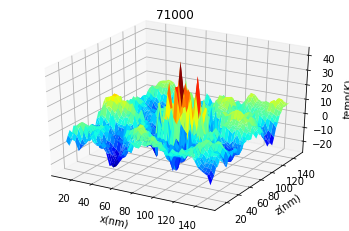

In [ ]:
#error map of expected and predicted heatmaps
import pandas as pd
import numpy as np
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import os

f = '/content/drive/My Drive/ML/csv/heatmap.71000.csv'
df = pd.read_csv(f)
x = df['x(nm)'].values
z = df['z(nm)'].values
temp = df['temp(K)'].values

error = temp - pred_temp

xx = np.linspace(min(x), max(x), 47)
zz = np.linspace(min(z), max(z), 47)
X, Z = np.meshgrid(xx, zz)
TEMP = griddata((x, z), error, (X, Z), method = 'linear')

fig = plt.figure()
ax = plt.axes(projection = '3d')
ax.plot_surface(X, Z, TEMP, cmap = 'jet')
ax.set_title(os.path.basename(f).split('.')[1])
ax.set_xlabel('x(nm)')
ax.set_ylabel('z(nm)')
ax.set_zlabel('temp(K)');

(1, 47, 47, 1)
[[[[0.03468969]
   [0.03500355]
   [0.034251  ]
   ...
   [0.03444788]
   [0.03465603]
   [0.03385337]]

  [[0.03560251]
   [0.03626178]
   [0.03555322]
   ...
   [0.03784529]
   [0.03773682]
   [0.03719296]]

  [[0.03543415]
   [0.0353844 ]
   [0.03508016]
   ...
   [0.03790006]
   [0.03812941]
   [0.03815547]]

  ...

  [[0.03541492]
   [0.03606226]
   [0.03503215]
   ...
   [0.03816365]
   [0.03864488]
   [0.03823826]]

  [[0.03549391]
   [0.03678824]
   [0.03607698]
   ...
   [0.03717617]
   [0.03786264]
   [0.0379079 ]]

  [[0.03498935]
   [0.03662677]
   [0.0375982 ]
   ...
   [0.03767571]
   [0.03736081]
   [0.03682876]]]]
(47, 47)
[[0.03468969 0.03500355 0.034251   ... 0.03444788 0.03465603 0.03385337]
 [0.03560251 0.03626178 0.03555322 ... 0.03784529 0.03773682 0.03719296]
 [0.03543415 0.0353844  0.03508016 ... 0.03790006 0.03812941 0.03815547]
 ...
 [0.03541492 0.03606226 0.03503215 ... 0.03816365 0.03864488 0.03823826]
 [0.03549391 0.03678824 0.03607698 ... 0.

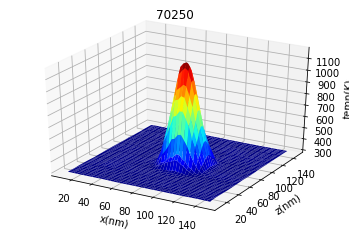

In [ ]:
#prediction between 2 frames using predicted heatmap
#3D plot of predicted heatmap
time1 = 70000
time2 = pred_time

pred_time = int((time1 + time2) / 2)
input_time1 = int(time1 / 1000 - 70)

predict = model.predict([temp_in1[[input_time1]], predict])
print(predict.shape)
print(predict)

predict_matrix = predict.reshape(47, 47)
print(predict_matrix.shape)
print(predict_matrix)

inverse = scaler.inverse_transform(predict_matrix)
print(inverse.shape)
print(inverse)

pred_temp = inverse.reshape(2209)
print(pred_temp.shape)
print(pred_temp)

x = df['x(nm)'].values
z = df['z(nm)'].values

xx = np.linspace(min(x), max(x), 47)
zz = np.linspace(min(z), max(z), 47)
X, Z = np.meshgrid(xx, zz)
TEMP = griddata((x, z), pred_temp, (X, Z), method = 'linear')

fig = plt.figure()
ax = plt.axes(projection = '3d')
ax.plot_surface(X, Z, TEMP, cmap = 'jet')
ax.set_title(pred_time)
ax.set_xlabel('x(nm)')
ax.set_ylabel('z(nm)')
ax.set_zlabel('temp(K)');

In [ ]:
#implementing own MSE function

import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras
import keras.backend as K

def my_mse(y_true, y_pred):
  return K.mean(K.square(y_true-y_pred))

temp = []

for n in range (70, 371):
  n_int = str(1000 * n)
  f = '/content/drive/My Drive/ML/csv/heatmap.' + n_int + '.csv'
  df = pd.read_csv(f)
  temp.append(df['temp(K)'].values)

temp = np.array(temp)

temp_reshape = temp.reshape(-1, 1)

scaler = MinMaxScaler()
normalized = scaler.fit_transform(temp_reshape)

normalized_matrix = normalized.reshape(301, 47, 47, 1)

temp_in1 = normalized_matrix[:-2]
temp_in2 = normalized_matrix[2:]
temp_out = normalized_matrix[1:-1]


visible_1 = keras.Input(shape = temp_in1.shape[1:])
cnn_1 = keras.layers.Conv2D(128, kernel_size = (3, 3), padding = 'same', activation = 'relu')(visible_1)
dropout_1 = keras.layers.Dropout(0.1)(cnn_1)

visible_2 = keras.Input(shape = temp_in2.shape[1:])
cnn_2 = keras.layers.Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu')(visible_2)
dropout_2 = keras.layers.Dropout(0.1)(cnn_2)

merge = keras.layers.Concatenate(axis=3)([dropout_1, dropout_2])

cnn_3 = keras.layers.Conv2D(64, kernel_size = (3, 3), padding = 'same', activation = 'relu')(merge)
dropout_3 = keras.layers.Dropout(0.1)(cnn_3)

output = keras.layers.Conv2D(1, kernel_size = (3, 3), padding = 'same', activation = 'relu')(dropout_3)

model = keras.Model(inputs = [visible_1, visible_2], outputs = output)

model.compile(loss = my_mse, optimizer = keras.optimizers.Adam(lr = 1e-3, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                      patience = 5, verbose = 1, mode = 'auto',
                                      restore_best_weights = True)

model.fit([temp_in1, temp_in2], temp_out, validation_split = 0.1, epochs = 100, callbacks=[monitor])

Epoch 1/100
9/9 [==============================] - 1s 121ms/step - loss: 0.0023 - val_loss: 2.0693e-04
Epoch 2/100
9/9 [==============================] - 0s 50ms/step - loss: 3.4407e-04 - val_loss: 2.5026e-04
Epoch 3/100
9/9 [==============================] - 0s 50ms/step - loss: 2.5407e-04 - val_loss: 6.2161e-05
Epoch 4/100
9/9 [==============================] - 0s 51ms/step - loss: 1.6461e-04 - val_loss: 6.1680e-05
Epoch 5/100
9/9 [==============================] - 0s 50ms/step - loss: 1.4570e-04 - val_loss: 5.9383e-05
Epoch 6/100
9/9 [==============================] - 0s 51ms/step - loss: 1.3250e-04 - val_loss: 6.2103e-05
Epoch 00006: early stopping


0 1
10 2
50 3
100 4


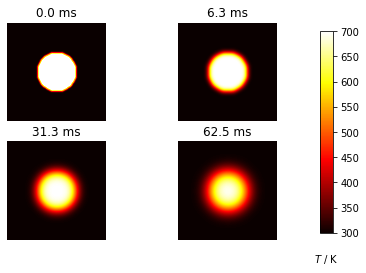

In [ ]:
#two-dimensional diffusion equation
import numpy as np
import matplotlib.pyplot as plt

#plate size, mm
w = h = 10.
#intervals in x-, y- directions, mm
dx = dy = 0.1
#thermal diffusivity of steel, mm2.s-1
D = 4.

Tcool, Thot = 300, 700

nx, ny = int(w / dx), int(h / dy)

dx2, dy2 = dx * dx, dy * dy
dt = dx2 * dy2 / (2 * D * (dx2 + dy2))

u0 = Tcool * np.ones((nx, ny))
u = u0.copy()

#initial conditions - ring of inner radius r, width dr centred at (cx, cy) (mm)
r, cx, cy = 2, 5, 5
r2 = r**2
for i in range(nx):
  for j in range(ny):
    p2 = (i * dx - cx)**2 + (j * dy - cy)**2
    if p2 < r2:
      u0[i, j] = Thot

'''
for i in range(1, nx - 1):
  for j in range(1, ny - 1):
    uxx = (u0[i + 1, j] - 2 * u0[i, j] + u0[i - 1, j]) / dx2
    uyy = (u0[i, j + 1] - 2 * u0[i, j] + u0[i, j - 1]) / dy2
    u[i, j] = u0[i, j] + dt * D * (uxx + uyy)
'''

def do_timestep(u0, u):
  #propagate with forward-difference in time, central-difference in space
  u[1:-1, 1:-1] = u0[1:-1, 1:-1] + D * dt * (
  (u0[2:, 1:-1] - 2 * u0[1:-1, 1:-1]+ u0[:-2, 1:-1]) / dx2
  + (u0[1:-1, 2:] - 2 * u0[1:-1, 1:-1] + u0[1:-1, :-2]) / dy2)

  u0 = u.copy()
  return u0, u

#number of timesteps
nsteps = 101
#output 4 figures at these timesteps
mfig = [0, 10, 50, 100]
fignum = 0
fig = plt.figure()
for m in range(nsteps):
  u0, u = do_timestep(u0, u)
  if m in mfig:
    fignum += 1
    print(m, fignum)
    ax = fig.add_subplot(220 + fignum)
    im = ax.imshow(u.copy(), cmap = plt.get_cmap('hot'), vmin = Tcool, vmax = Thot)
    ax.set_axis_off()
    ax.set_title('{:.1f} ms'.format(m * dt * 1000))
fig.subplots_adjust(right = 0.85)
cbar_ax = fig.add_axes([0.9, 0.15, 0.03, 0.7])
cbar_ax.set_xlabel('$T$ / K', labelpad = 20)
fig.colorbar(im, cax = cbar_ax)
plt.show()

In [ ]:
#physics-informed loss function
import tensorflow as tf

def u(temp, x, z):
  u = neural_net(tf.concat([temp, x, z], 1), weights, biases)
  return u

def f(temp, x, z):
  u = u(temp, x, z)
  u_t = tf.gradients(u, temp)[0]
  u_x = tf.gradients(u, x)[0]
  u_xx = tf.gradients(u_x, x)[0]
  u_z = tf.gradients(u, z)[0]
  u_zz = tf.gradients(u_z, z)[0]
  f = u_t - 1 * (u_xx + u_zz)
  return f

In [ ]:
#finite differences
import pandas as pd
import numpy as np
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

x = z = 148.
dx = dz = 3.
nx, nz = 47, 47

dx2, dz2 = dx * dx, dz * dz
C = .5
#dt = dx2 * dz2 / (2 * C * (dx2 + dz2))
dt = 1.

#initial conditions
f = '/content/drive/My Drive/ML/csv/heatmap.70000.csv'
df = pd.read_csv(f)
x = df['x(nm)'].values
z = df['z(nm)'].values
temp = df['temp(K)'].values

u0 = temp.reshape(47, 47)
u = u0.copy()

'''
for i in range(1, nx - 1):
  for j in range(1, nz - 1):
    uxx = (u0[i + 1, j] - 2 * u0[i, j] + u0[i - 1, j]) / dx2
    uzz = (u0[i, j + 1] - 2 * u0[i, j] + u0[i, j - 1]) / dz2
    u[i, j] = u0[i, j] + C * dt * (uxx + uzz)
'''

def timestep(u0, u):
  #propagate with forward-difference in time, central-difference in space
  u[1:-1, 1:-1] = u0[1:-1, 1:-1] + C * dt * (
  (u0[2:, 1:-1] - 2 * u0[1:-1, 1:-1] + u0[:-2, 1:-1]) / dx2
  + (u0[1:-1, 2:] - 2 * u0[1:-1, 1:-1] + u0[1:-1, :-2]) / dz2)

  u0 = u.copy()
  return u0, u

for n in range(70, 371):
  u0, u = timestep(u0, u)
  u_reshape = u.reshape(2209)
  print(u)
  #xx = np.linspace(min(x), max(x), 47)
  #zz = np.linspace(min(z), max(z), 47)
  #X, Z = np.meshgrid(xx, zz)
  #TEMP = griddata((x, z), u_reshape, (X, Z), method = 'linear')

  #fig = plt.figure()
  #ax = plt.axes(projection = '3d')
  #ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  #ax.set_title(1000 * n)
  #ax.set_xlabel('x(nm)')
  #ax.set_ylabel('z(nm)')
  #ax.set_zlabel('temp(K)');

[[302.22914972 303.71586187 303.63032056 ... 300.41394653 299.18761309
  300.11567284]
 [302.02357619 303.35981156 303.41096624 ... 304.81293344 304.4656987
  308.89995684]
 [301.34659528 302.59978702 303.64059923 ... 306.30660677 306.35397243
  309.13295022]
 ...
 [298.01168366 300.84692134 301.29832067 ... 304.90091027 305.04323545
  305.61455688]
 [297.49452762 301.077463   300.95697175 ... 302.64863791 302.44486787
  301.9233926 ]
 [300.16041423 305.36859604 305.27069076 ... 305.12044003 304.54473577
  305.10376655]]
[[302.22914972 303.71586187 303.63032056 ... 300.41394653 299.18761309
  300.11567284]
 [302.02357619 303.26597518 303.32449761 ... 304.73888162 304.54301431
  308.89995684]
 [301.34659528 302.24717199 303.15078406 ... 306.08234572 306.40311535
  309.13295022]
 ...
 [298.01168366 300.80668165 300.96595214 ... 304.55128542 304.84199857
  305.61455688]
 [297.49452762 301.09730548 300.94932253 ... 302.67433418 302.68823066
  301.9233926 ]
 [300.16041423 305.36859604 305.2

[[302.22914972 303.71586187 303.63032056 ... 300.41394653 299.18761309
  300.11567284]
 [302.02357619 303.44346633 303.47817798 ... 304.87222707 304.36774937
  308.89995684]
 [301.34659528 303.05046345 304.23743617 ... 306.61704851 306.27428844
  309.13295022]
 ...
 [298.01168366 300.85598955 301.75635309 ... 305.32132873 305.32522439
  305.61455688]
 [297.49452762 301.04990998 300.97648102 ... 302.64287013 302.11224277
  301.9233926 ]
 [300.16041423 305.36859604 305.27069076 ... 305.12044003 304.54473577
  305.10376655]]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


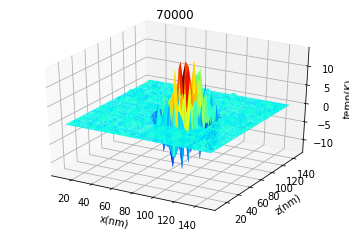

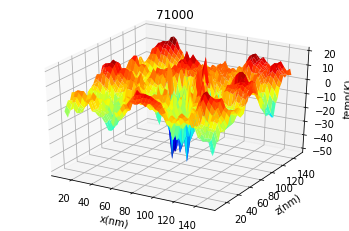

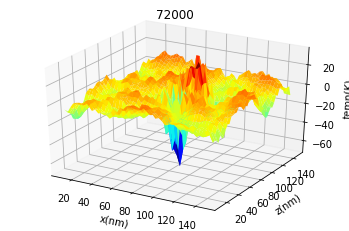

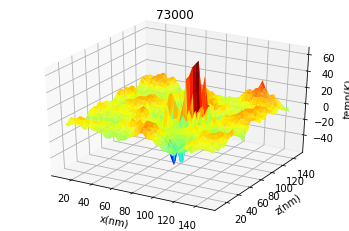

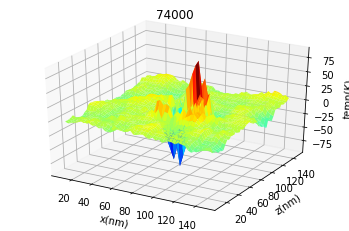

...

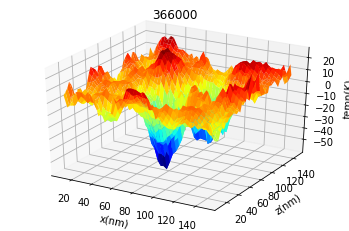

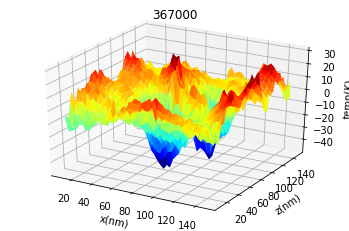

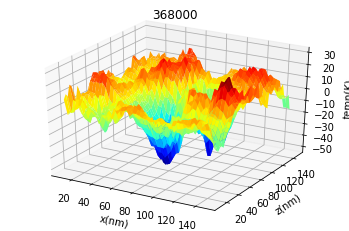

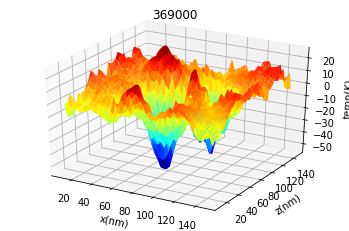

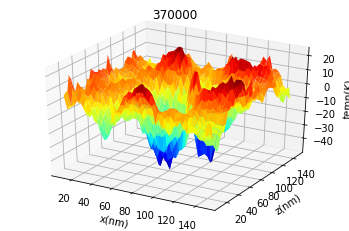

In [ ]:
#finite differences
#error maps of expected and predicted heatmaps
import pandas as pd
import numpy as np
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

x = z = 148.
dx = dz = 3.
nx, nz = 47, 47

dx2, dz2 = dx * dx, dz * dz
C = .8
#dt = dx2 * dz2 / (2 * C * (dx2 + dz2))
dt = .65
#dt = .75
#dt = .65

#initial conditions
f = '/content/drive/My Drive/ML/csv/heatmap.70000.csv'
df = pd.read_csv(f)
temp = df['temp(K)'].values

u0 = temp.reshape(47, 47)
u = u0.copy()
print(u)

'''
for i in range(1, nx - 1):
  for j in range(1, nz - 1):
    uxx = (u0[i + 1, j] - 2 * u0[i, j] + u0[i - 1, j]) / dx2
    uzz = (u0[i, j + 1] - 2 * u0[i, j] + u0[i, j - 1]) / dz2
    u[i, j] = u0[i, j] + C * dt * (uxx + uzz)
'''

def timestep(u0, u):
  #propagate with forward-difference in time, central-difference in space
  u[1:-1, 1:-1] = u0[1:-1, 1:-1] + C * dt * (
  (u0[2:, 1:-1] - 2 * u0[1:-1, 1:-1] + u0[:-2, 1:-1]) / dx2
  + (u0[1:-1, 2:] - 2 * u0[1:-1, 1:-1] + u0[1:-1, :-2]) / dz2)

  u0 = u.copy()
  return u0, u

for n in range(70, 371):
  n_str = str(1000 * n)
  f = '/content/drive/My Drive/ML/csv/heatmap.' + n_str + '.csv'
  df = pd.read_csv(f)
  x = df['x(nm)'].values
  z = df['z(nm)'].values
  temp = df['temp(K)'].values

  u0, u = timestep(u0, u)
  u_reshape = u.reshape(2209)

  error = temp - u_reshape

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), error, (X, Z), method = 'linear')

  fig = plt.figure()
  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(os.path.basename(f).split('.')[1])
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)');
  #fig.savefig('/content/drive/My Drive/ML/fd_error/fd.' + n_str + '.png')

In [ ]:
#implementing dynamic learning rate
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras


temp = []

for n in range (70, 371):
  n_int = str(1000 * n)
  f = '/content/drive/My Drive/ML/csv/heatmap.' + n_int + '.csv'
  df = pd.read_csv(f)
  temp.append(df['temp(K)'].values)

temp = np.array(temp)

temp_reshape = temp.reshape(-1, 1)

scaler = MinMaxScaler()
normalized = scaler.fit_transform(temp_reshape)

normalized_matrix = normalized.reshape(301, 47, 47, 1)

temp_in = normalized_matrix[:-1]

temp_out = normalized_matrix[1:]

for n in range(1, 61):
  m = 5 * n
  inputs = normalized_matrix[:-m]
  temp_in = np.concatenate((temp_in, inputs))
  
  outputs = normalized_matrix[m:]
  temp_out = np.concatenate((temp_out, outputs))

dt = []

for n in range (47 * 47 * (300)):
  dt.append(1 / 300)

for m in range (1, 61):
  for n in range (47 * 47 * (301 - 5 * m)):
    dt.append(5 * m / 300)

dt = np.array(dt)

dt_reshape = dt.reshape(temp_in.shape)

visible_1 = keras.Input(shape = temp_in.shape[1:])
cnn_1 = keras.layers.Conv2D(128, kernel_size = (3, 3), padding = 'same', activation = 'relu')(visible_1)
dropout_1 = keras.layers.Dropout(0.1)(cnn_1)

visible_2 = keras.Input(shape = dt_reshape.shape[1:])

merge = keras.layers.Concatenate(axis = 3)([dropout_1, visible_2])

cnn_2 = keras.layers.Conv2D(64, kernel_size = (3, 3), padding = 'same', activation = 'relu')(merge)
dropout_2 = keras.layers.Dropout(0.1)(cnn_2)

output = keras.layers.Conv2D(1, kernel_size = (3, 3), padding = 'same', activation = 'relu')(dropout_2)

model = keras.Model(inputs = [visible_1, visible_2], outputs = output)

model.compile(loss = 'mse', optimizer = keras.optimizers.Adam(lr = 1e-3, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                        patience = 5, verbose = 1, mode = 'auto',
                                        restore_best_weights = True)
                                        
                        
reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00000001)

history = model.fit([temp_in, dt_reshape], temp_out, validation_split = 0.14, epochs = 100, callbacks=[reduce_lr, monitor])

FileNotFoundError: ignored

In [ ]:
#finite differences
#error comparisons with frame interpolation CNN predictions
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

x = z = 148.
dx = dz = 3.
nx, nz = 47, 47

dx2, dz2 = dx * dx, dz * dz
C = .5
#dt = dx2 * dz2 / (2 * C * (dx2 + dz2))
dt = 1.

#initial conditions
f = '/content/drive/My Drive/ML/csv/heatmap.70000.csv'
df = pd.read_csv(f)
x = df['x(nm)'].values
z = df['z(nm)'].values
temp = df['temp(K)'].values

u0 = temp.reshape(47, 47)
u = u0.copy()

def timestep(u0, u):
  #propagate with forward-difference in time, central-difference in space
  u[1:-1, 1:-1] = u0[1:-1, 1:-1] + C * dt * (
  (u0[2:, 1:-1] - 2 * u0[1:-1, 1:-1] + u0[:-2, 1:-1]) / dx2
  + (u0[1:-1, 2:] - 2 * u0[1:-1, 1:-1] + u0[1:-1, :-2]) / dz2)

  u0 = u.copy()
  return u0, u

for n in range(70, 367):
  u0, u = timestep(u0, u)
  u_reshape = u.reshape(2209)
  time1 = n*1000
  time2 = (n+2)*1000

  pred_time = int((time1 + time2) / 2)
  input_time1 = int(time1 / 1000 - 70)
  input_time2 = int(time2 / 1000 - 70)

  predict = model.predict([temp_in1[[input_time1]], temp_in1[[input_time2]]])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(2209)

  difs = []
  counter = 0
  while counter < len(pred_temp):
    dif = u_reshape[counter] - pred_temp[counter]
    difs.append(dif)
    counter += 1
  

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), difs, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(str(pred_time))
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  plt.savefig('/content/drive/My Drive/ML/FramePred_V_Finite/' + str(pred_time))
  plt.clf()
  plt.close()

In [ ]:
#finite differences
#error comparisons with real values
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

x = z = 148.
dx = dz = 3.
nx, nz = 47, 47

dx2, dz2 = dx * dx, dz * dz
C = .5
#dt = dx2 * dz2 / (2 * C * (dx2 + dz2))
dt = 1.

#initial conditions
f = '/content/drive/My Drive/ML/csv/heatmap.70000.csv'
df = pd.read_csv(f)
x = df['x(nm)'].values
z = df['z(nm)'].values
temp = df['temp(K)'].values

u0 = temp.reshape(47, 47)
u = u0.copy()

def timestep(u0, u):
  #propagate with forward-difference in time, central-difference in space
  u[1:-1, 1:-1] = u0[1:-1, 1:-1] + C * dt * (
  (u0[2:, 1:-1] - 2 * u0[1:-1, 1:-1] + u0[:-2, 1:-1]) / dx2
  + (u0[1:-1, 2:] - 2 * u0[1:-1, 1:-1] + u0[1:-1, :-2]) / dz2)

  u0 = u.copy()
  return u0, u

for n in range(70, 367):
  u0, u = timestep(u0, u)
  u_reshape = u.reshape(2209)
  time = (n+1)*1000

  df = pd.read_csv('/content/drive/My Drive/ML/csv/heatmap.' + str(time) + '.csv')
  temps = df['temp(K)'].values

  difs = []
  counter = 0
  while counter < len(temps):
    dif = u_reshape[counter] - temps[counter]
    difs.append(dif)
    counter += 1
  

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), difs, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(str(time))
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  plt.savefig('/content/drive/My Drive/ML/Finite_Minus_Real/' + str(time))
  plt.clf()
  plt.close()

In [ ]:
#finite differences
#error comparisons with dt-matrix CNN
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

x = z = 148.
dx = dz = 3.
nx, nz = 47, 47

dx2, dz2 = dx * dx, dz * dz
C = .5
#dt = dx2 * dz2 / (2 * C * (dx2 + dz2))
dt = 1.

#initial conditions
f = '/content/drive/My Drive/ML/csv/heatmap.70000.csv'
df = pd.read_csv(f)
x = df['x(nm)'].values
z = df['z(nm)'].values
temp = df['temp(K)'].values

u0 = temp.reshape(47, 47)
u = u0.copy()

def timestep(u0, u):
  #propagate with forward-difference in time, central-difference in space
  u[1:-1, 1:-1] = u0[1:-1, 1:-1] + C * dt * (
  (u0[2:, 1:-1] - 2 * u0[1:-1, 1:-1] + u0[:-2, 1:-1]) / dx2
  + (u0[1:-1, 2:] - 2 * u0[1:-1, 1:-1] + u0[1:-1, :-2]) / dz2)

  u0 = u.copy()
  return u0, u

for n in range(70, 367):
  u0, u = timestep(u0, u)
  u_reshape = u.reshape(2209)
  time = (n+1)*1000

  time = (n+1)*1000
  time_step = 1

  input_time = int(time / 1000 - 70)

  dtt = []

  for n in range (47 * 47):
    dtt.append(time_step / 300)

  dtt = np.array(dtt)

  input_dt = dtt.reshape(1, 47, 47, 1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(47, 47)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(2209)


  difs = []
  counter = 0
  while counter < len(pred_temp):
    dif = u_reshape[counter] - pred_temp[counter]
    difs.append(dif)
    counter += 1
  

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), difs, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(str(time))
  ax.set_xlabel('x(nm)')
  ax.set_ylabel('z(nm)')
  ax.set_zlabel('temp(K)')
  plt.savefig('/content/drive/My Drive/ML/Finite_Minus_DTMatrixPred/' + str(time))
  plt.clf()
  plt.close()

In [ ]:
# graphing all the files for salt crystals
import csv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import griddata
from mpl_toolkits import mplot3d

for n in range(1, 21):
  n_int = 500*n
  cur_file = "/content/drive/My Drive/ML/csv1/phase_field_" + str(n_int) + ".csv"
  df = pd.read_csv(cur_file)
  x = df['x'].values
  z = df['z'].values
  values = df['value'].values

  xx = np.linspace(min(x), max(x), 47)
  zz = np.linspace(min(z), max(z), 47)
  X, Z = np.meshgrid(xx, zz)
  TEMP = griddata((x, z), values, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(str(n_int))
  ax.set_xlabel('x')
  ax.set_ylabel('z')
  ax.set_zlabel('value')
  plt.savefig('/content/drive/My Drive/ML/crystal_heatmaps/' + str(n_int))
  plt.clf()
  plt.close()

In [ ]:
#2D plot of all phase-fields
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

for n in range(1, 21):
  n_str = str(500 * n)
  f = '/content/drive/My Drive/ML/csv1/phase_field_' + n_str + '.csv'
  df = pd.read_csv(f)
  pf = df['value'].values

  pf = np.array(pf)
  pf_matrix = pf.reshape(499, 499)

  plt.imshow(pf_matrix, cmap = 'jet')
  plt.title('0' + n_str)
  plt.savefig("/content/drive/My Drive/ML/2DCrystal/" + n_str)
  plt.clf()
  plt.close()


In [ ]:
#crystals
#temp at time = t and dt as inputs, temp at time = t + dt as outputs
#dt is a 2D matrix, output is a 2D matrix
#use convolutional neural network
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras


temp = []

for n in range (1, 21):
  n_int = str(500 * n)
  f = '/content/drive/My Drive/ML/csv1/phase_field_' + n_int + '.csv'
  df = pd.read_csv(f)
  temp.append(df['value'].values)

temp = np.array(temp)

temp_reshape = temp.reshape(-1, 1)

scaler = MinMaxScaler()
normalized = scaler.fit_transform(temp_reshape)

normalized_matrix = normalized.reshape(20, 499, 499, 1)

temp_in = normalized_matrix[:-1]

temp_out = normalized_matrix[1:]

for n in range(1, 5):
  m = 5 * n
  inputs = normalized_matrix[:-m]
  temp_in = np.concatenate((temp_in, inputs))
  
  outputs = normalized_matrix[m:]
  temp_out = np.concatenate((temp_out, outputs))

dt = []

for n in range(499 * 499 * (20)):
 dt.append(1 / 20)

for m in range(1, 5):
  for n in range (499 * 499 * (20 - 5 * m)):
    dt.append(5 * m / 20)

dt = np.array(dt)

dt_reshape = dt.reshape(50,499,499,1)

visible_1 = keras.Input(shape = temp_in.shape[1:])
cnn_1 = keras.layers.Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu')(visible_1)

visible_2 = keras.Input(shape = dt_reshape.shape[1:])

merge = keras.layers.Concatenate(axis = 3)([cnn_1, visible_2])

cnn_2 = keras.layers.Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu')(merge)

output = keras.layers.Conv2D(1, kernel_size = (3, 3), padding = 'same', activation = 'relu')(cnn_2)

model = keras.Model(inputs = [visible_1, visible_2], outputs = output)

model.compile(loss = 'mse', optimizer = keras.optimizers.Adam(lr = 1e-3, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                        patience = 5, verbose = 1, mode = 'auto',
                                        restore_best_weights = True)

reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00000001)

history = model.fit([temp_in, dt_reshape], temp_out, validation_split = 0.2, epochs = 100, callbacks=[reduce_lr, monitor])



Epoch 1/100
2/2 [==============================] - 2s 1s/step - loss: 0.1308 - val_loss: 0.1560 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 0s 99ms/step - loss: 0.0780 - val_loss: 0.0773 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 0s 100ms/step - loss: 0.0374 - val_loss: 0.0280 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0117 - val_loss: 0.0142 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0071 - val_loss: 0.0270 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 97ms/step - loss: 0.0181 - val_loss: 0.0340 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 101ms/step - loss: 0.0204 - val_loss: 0.0276 - lr: 0.0010
Epoch 8/100
2/2 [==============================] - 0s 104ms/step - loss: 0.0131 - val_loss: 0.0188 - lr: 0.0010
Epoch 9/100
2/2 [==============================] - 0s 102ms/step - loss: 0.0069 - val_loss: 0.0148 - lr: 0.00

1


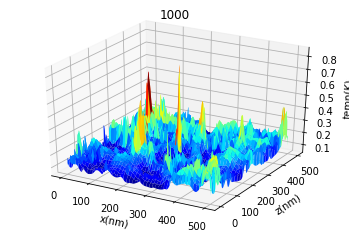

In [ ]:
#prediction for convolutional neural network for crystals
#3D plot of predicted heatmap
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

time = 500
time_step = 1

pred_time = time + time_step * 500

input_time = int(time / 500 )
print(input_time)

dt = []

for n in range (499 * 499):
  dt.append(time_step / 20)

dt = np.array(dt)

input_dt = dt.reshape(1, 499, 499, 1)

predict = model.predict([temp_in[[input_time]], input_dt])

predict_matrix = predict.reshape(499, 499)

inverse = scaler.inverse_transform(predict_matrix)

pred_temp = inverse.reshape(249001)

x = df['x'].values
z = df['z'].values

xx = np.linspace(min(x), max(x), 499)
zz = np.linspace(min(z), max(z), 499)
X, Z = np.meshgrid(xx, zz)
TEMP = griddata((x, z), pred_temp, (X, Z), method = 'linear')

ax = plt.axes(projection = '3d')
ax.plot_surface(X, Z, TEMP, cmap = 'jet')
ax.set_title(pred_time)
ax.set_xlabel('x(nm)')
ax.set_ylabel('z(nm)')
ax.set_zlabel('temp(K)');

Text(0.5, 0, 'temp(K)')

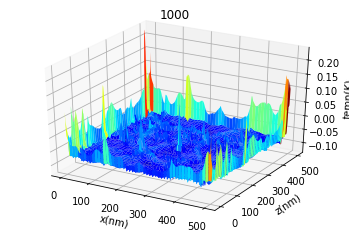

In [ ]:
#error map of prediction
df = pd.read_csv("/content/drive/My Drive/ML/csv1/phase_field_1000.csv")
values = df['value'].values
difs = []
pointer=0
while pointer < len(values):
  difs.append(values[pointer] - pred_temp[pointer])
  pointer += 1

TEMP = griddata((x, z), difs, (X, Z), method = 'linear')

ax = plt.axes(projection = '3d')
ax.plot_surface(X, Z, TEMP, cmap = 'jet')
ax.set_title(pred_time)
ax.set_xlabel('x(nm)')
ax.set_ylabel('z(nm)')
ax.set_zlabel('temp(K)')

In [ ]:
# 2D and 3D graphs of all predictions

for n in range(1, 21):
  time = (500*n)

  time_step = 1
  pred_time = time + time_step * 500
  input_time = int(time/500)

  dt = []
  for n in range(499*499):
    dt.append(time_step/20)
  dt = np.array(dt)

  input_dt = dt.reshape(1,499,499,1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(499, 499)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(249001)

  TEMP = griddata((x, z), pred_temp, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(pred_time)
  ax.set_xlabel('x')
  ax.set_ylabel('z')
  ax.set_zlabel('value')
  plt.savefig("/content/drive/My Drive/ML/salt_predictions_dt_3D/" + str(pred_time))
  plt.clf()
  plt.close()

  pred_temp_matrix = pred_temp.reshape(499, 499)

  plt.imshow(pred_temp_matrix, cmap = 'jet')
  plt.title(pred_time)
  plt.savefig("/content/drive/My Drive/ML/salt_predictions_dt_2D/" + str(pred_time))
  plt.clf()
  plt.close()



In [ ]:
# 2D and 3D error maps of dt-matrix predictions for salt

for n in range(1, 21):
  time = (500*n)

  time_step = 1
  pred_time = time + time_step * 500
  input_time = int(time/500)

  dt = []
  for n in range(499*499):
    dt.append(time_step/20)
  dt = np.array(dt)

  input_dt = dt.reshape(1,499,499,1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(499, 499)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(249001)

  difs = []
  pointer = 0
  cur_file = "/content/drive/My Drive/ML/csv1/phase_field_" + str(pred_time) + ".csv"
  df = pd.read_csv(cur_file)
  real_values = df['value'].values
  while pointer < len(real_values):
    difs.append(real_values[pointer] - pred_temp[pointer])
    pointer += 1

  difs = np.array(difs)

  TEMP = griddata((x, z), difs, (X, Z), method = 'linear')

  ax = plt.axes(projection = '3d')
  ax.plot_surface(X, Z, TEMP, cmap = 'jet')
  ax.set_title(pred_time)
  ax.set_xlabel('x')
  ax.set_ylabel('z')
  ax.set_zlabel('difference')
  plt.savefig("/content/drive/My Drive/ML/salt_difs_dt_3D/" + str(pred_time))
  plt.clf()
  plt.close()

  difs_matrix = difs.reshape(499, 499)

  plt.imshow(difs_matrix, cmap = 'jet')
  plt.title(pred_time)
  plt.savefig("/content/drive/My Drive/ML/salt_difs_dt_2D/" + str(pred_time))
  plt.clf()
  plt.close()



FileNotFoundError: ignored

In [ ]:
# 2D and 3D error maps of dt-matrix predictions for salt
from sklearn.metrics import mean_squared_error

all_difs = []
squared_all_difs = []
MSE = []

for n in range(1, 21):
  time = (500*n)

  time_step = 1
  pred_time = time + time_step * 500
  input_time = int(time/500)

  if pred_time == 10500:
    break

  dt = []
  for n in range(499*499):
    dt.append(time_step/20)
  dt = np.array(dt)

  input_dt = dt.reshape(1,499,499,1)

  predict = model.predict([temp_in[[input_time]], input_dt])

  predict_matrix = predict.reshape(499, 499)

  inverse = scaler.inverse_transform(predict_matrix)

  pred_temp = inverse.reshape(249001)

  difs = []
  pointer = 0
  cur_file = "/content/drive/My Drive/ML/csv1/phase_field_" + str(pred_time) + ".csv"
  df = pd.read_csv(cur_file)
  real_values = df['value'].values
  while pointer < len(real_values):
    difs.append(real_values[pointer] - pred_temp[pointer])
    pointer += 1

  all_difs.append([difs])
  squared_difs = []
  for value in difs:
    squared_difs.append(value**2)
  squared_all_difs.append([squared_difs])
  mse = mean_squared_error(real_values, pred_temp)
  MSE.append(mse)


print(f"The average MSE is {sum(MSE) / len(MSE)}.\n")
print(f"The maximum MSE is {max(MSE)}.\n")
print(f"The minimum MSE is {min(MSE)}.\n")



The average MSE is 0.011457899749128553.

The maximum MSE is 0.13212800913555586.

The minimum MSE is 0.004644980949339818.



In [ ]:
# Experimenting with different models to get better results
#crystals
#temp at time = t and dt as inputs, temp at time = t + dt as outputs
#dt is a 2D matrix, output is a 2D matrix
#use convolutional neural network
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras


temp = []

for n in range (1, 21):
  n_int = str(500 * n)
  f = '/content/drive/My Drive/ML/csv1/phase_field_' + n_int + '.csv'
  df = pd.read_csv(f)
  temp.append(df['value'].values)

temp = np.array(temp)

temp_reshape = temp.reshape(-1, 1)

scaler = MinMaxScaler()
normalized = scaler.fit_transform(temp_reshape)

normalized_matrix = normalized.reshape(20, 499, 499, 1)

temp_in = normalized_matrix[:-1]

temp_out = normalized_matrix[1:]

for n in range(1, 5):
  m = 5 * n
  inputs = normalized_matrix[:-m]
  temp_in = np.concatenate((temp_in, inputs))
  
  outputs = normalized_matrix[m:]
  temp_out = np.concatenate((temp_out, outputs))

dt = []

for n in range(499 * 499 * (20)):
 dt.append(1 / 20)

for m in range(1, 5):
  for n in range (499 * 499 * (20 - 5 * m)):
    dt.append(5 * m / 20)

dt = np.array(dt)

dt_reshape = dt.reshape(50,499,499,1)

visible_1 = keras.Input(shape = temp_in.shape[1:])
cnn_1 = keras.layers.Conv2D(32, kernel_size = (5, 5), padding = 'same', activation = 'relu')(visible_1)
#dropout_1 = keras.layers.Dropout(0.1)(cnn_1)

visible_2 = keras.Input(shape = dt_reshape.shape[1:])

merge = keras.layers.Concatenate(axis = 3)([cnn_1, visible_2])

cnn_2 = keras.layers.Conv2D(32, kernel_size = (5, 5), padding = 'same', activation = 'relu')(merge)
#dropout_2 = keras.layers.Dropout(0.1)(cnn_2)

output = keras.layers.Conv2D(1, kernel_size = (5, 5), padding = 'same', activation = 'relu')(cnn_2)

model = keras.Model(inputs = [visible_1, visible_2], outputs = output)

model.compile(loss = 'mse', optimizer = keras.optimizers.Adam(lr = 1e-3, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                        patience = 5, verbose = 1, mode = 'auto',
                                        restore_best_weights = True)

reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.00000001)

history = model.fit([temp_in, dt_reshape], temp_out, validation_split = 0.2, epochs = 100, callbacks=[reduce_lr, monitor])



Epoch 1/100
2/2 [==============================] - 6s 3s/step - loss: 0.1325 - val_loss: 0.0264 - lr: 0.0010
Epoch 2/100
2/2 [==============================] - 1s 513ms/step - loss: 0.0177 - val_loss: 0.1049 - lr: 0.0010
Epoch 3/100
2/2 [==============================] - 1s 512ms/step - loss: 0.0189 - val_loss: 0.0264 - lr: 0.0010
Epoch 4/100
2/2 [==============================] - 1s 520ms/step - loss: 0.0202 - val_loss: 0.0218 - lr: 0.0010
Epoch 5/100
2/2 [==============================] - 1s 525ms/step - loss: 0.0253 - val_loss: 0.0244 - lr: 0.0010
Epoch 6/100
2/2 [==============================] - 1s 523ms/step - loss: 0.0132 - val_loss: 0.0580 - lr: 0.0010
Epoch 7/100
2/2 [==============================] - 1s 511ms/step - loss: 0.0127 - val_loss: 0.0536 - lr: 0.0010
Epoch 8/100
2/2 [==============================] - 1s 522ms/step - loss: 0.0117 - val_loss: 0.0232 - lr: 0.0010
Epoch 9/100
2/2 [==============================] - 1s 508ms/step - loss: 0.0075 - val_loss: 0.0156 - lr: 0.

32 by 32, no dropout, 3,3: loss: 0.0069 - val_loss: 0.0148 - lr: 0.0010 

32 by 32, dropout, 3,3: loss: 0.0069 - val_loss: 0.0175 - lr: 0.0010

64 by 64, 3,3: Doesn't work.

48 by 48, no dropout, 3,3: loss: 0.0079 - val_loss: 0.0149 - lr: 0.0010

48 by 48, dropout, 3,3: Doesn't work.

48 by 48, dropout, 5,5 kernel size - Doesn't work.

32 by 32, dropout, 5,5 kernel - loss: 0.0110 - val_loss: 0.0228 - lr: 0.0010

32 by 32, dropout, 30,30 kernel - loss: 0.1476 - val_loss: 0.2088 - lr: 0.0010

32 by 32, no dropout, 5,5 - loss: 0.0064 - val_loss: 0.0163 - lr: 0.0010

32 by 32, no dropout, 7,7 - loss: 0.0083 - val_loss: 0.0154 - lr: 0.0010




In [ ]:
#pf at time = t inputs, pf at time = t + 1 as outputs
#use convolutional neural network
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow import keras
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

PF = []

for n in range(1, 21):
  n_str = str(500 * n)
  f = '/content/drive/My Drive/ML/csv1/phase_field_' + n_str + '.csv'
  df = pd.read_csv(f)
  pf = df['value'].values
  PF.append(pf)

PF = np.array(PF)

PF_matrix = PF.reshape(20, 499, 499, 1)

PF_in = PF_matrix[:-1]

PF_out = PF_matrix[1:]

x_train, x_test, y_train, y_test = train_test_split(PF_in, PF_out, test_size = 0.2, random_state = 42)

model = keras.models.Sequential()

model.add(keras.layers.Conv2D(64, kernel_size = (3, 3), padding = 'same', input_shape = PF_in.shape[1:]))
model.add(keras.layers.PReLU())
model.add(keras.layers.Dropout(0.1))

model.add(keras.layers.Conv2D(32, kernel_size = (3, 3), padding = 'same', input_shape = PF_in.shape[1:]))
model.add(keras.layers.PReLU())

model.add(keras.layers.Dropout(0.1))

model.add(keras.layers.Conv2D(16, kernel_size = (3, 3), padding = 'same', input_shape = PF_in.shape[1:]))
model.add(keras.layers.PReLU())

model.add(keras.layers.Conv2D(1, kernel_size = (3, 3), padding = 'same'))
model.add(keras.layers.PReLU())

model.compile(loss = 'mean_squared_error', optimizer = keras.optimizers.Adam(lr = 1e-4, decay = 1e-6))

monitor = keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 1e-3,
                                        patience = 5, verbose = 1, mode = 'auto',
                                        restore_best_weights = True)

reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0000000000001)


history = model.fit(x_train, y_train, validation_data = (x_test, y_test), epochs = 100, callbacks=[monitor, reduce_lr])

model.summary()

Epoch 1/100


ResourceExhaustedError: ignored

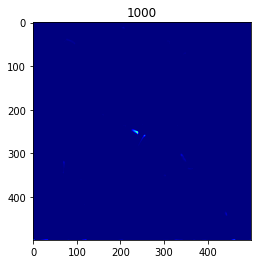

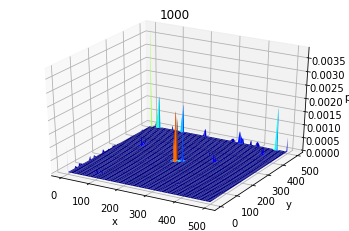

In [ ]:
#prediction for convolutional neural network
#2D and 3D plots of predicted phase-fields
time = 500
pred_time = time + 500

input_time = int(time / 500 - 1)

predict = model.predict(PF_in[[input_time]])

predict_matrix = predict.reshape(499, 499)

plt.imshow(predict_matrix, cmap = 'jet')
plt.title(pred_time)
plt.show()

predict_reshape = predict_matrix.reshape(249001)

x = []
for n in range(1, 500):
  for m in range(1, 500):
    x.append(m)
x = np.array(x)

y = []
for n in range(1, 500):
  for m in range(1, 500):
    y.append(n)
y = np.array(y)

xx = np.linspace(min(x), max(x), 499)
yy = np.linspace(min(y), max(y), 499)
X, Y = np.meshgrid(xx, yy)
PF = griddata((x, y), predict_reshape, (X, Y), method = 'linear')

fig = plt.figure()
ax = plt.axes(projection = '3d')
ax.plot_surface(X, Y, PF, cmap = 'jet')
ax.set_title(pred_time)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('pf');